# PFM: Exploratory Data Analysis Electricity SNP 

En este documento se lleva a cabo un EDA del dataset que reúne los parámetros eléctricos de la isla de Tenerife. Se utiliza el lenguaje Python por su versatilidad y gran cantidad de librerías. 

El objetivo es tener una mejor comprensión de los datos y extraer conclusiones de utilidad para la posterior construcción del modelo de aprendizaje.


In [45]:
# Importamos las librerías
### Escribe aquí tu código ###
import sklearn
from sklearn import datasets
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from datetime import date, datetime
import pytz
import seaborn as sns

# Librerias pickle y csv
import pickle
import csv


## **1. Abrir el dataset**

A continuación abrimos el dataset ya limpio, previamente guardado en formato pickle. 

In [72]:
def load_obj(name ):
       with open('obj/' + name + '.pkl', 'rb') as f:
           return pickle.load(f)

#dataset=load_obj('df_Tenerife_Electricity_full_2019_clean');
dataset=load_obj('df_Tenerife_Electricity_2020_07_clean');
leyenda=load_obj('dict_descripcion_df_Electricity');


In [73]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4464 entries, 2020-07-01 00:00:00 to 2020-07-31 23:50:00
Data columns (total 11 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Generacion_no_renovable_MW  4464 non-null   float64
 1   Generacion_renovable_MW     4464 non-null   float64
 2   Demanda_real_MW             4464 non-null   float64
 3   Generacion_FV_MW            4464 non-null   float64
 4   Generacion_TV_MW            4464 non-null   float64
 5   Generacion_CC_MW            4464 non-null   float64
 6   Generacion_EO_MW            4464 non-null   float64
 7   Generacion_TG_MW            4464 non-null   float64
 8   Generacion_MD_MW            4464 non-null   float64
 9   Demanda_programada_MW       4464 non-null   float64
 10  Precio_generacion_€MWh      4464 non-null   float64
dtypes: float64(11)
memory usage: 418.5 KB


In [74]:
dataset.describe()

,Generacion_no_renovable_MW,Generacion_renovable_MW,Demanda_real_MW,Generacion_FV_MW,Generacion_TV_MW,Generacion_CC_MW,Generacion_EO_MW,Generacion_TG_MW,Generacion_MD_MW,Demanda_programada_MW,Precio_generacion_€MWh
count,4464.000000,4464.000000,4464.000000,4464.000000,4464.000000,4464.000000,4464.000000,4464.000000,4464.000000,4464.000000,4464.000000
mean,258.707773,106.247110,364.954884,24.008109,79.366555,140.875179,82.239001,14.194848,24.271192,367.145565,140.863804
std,64.179817,66.491544,67.450088,29.897334,28.405799,30.718256,49.031394,26.721438,10.379995,64.653582,76.610679
min,4.500000,0.000000,4.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,244.600000,100.490000
25%,205.700000,59.875000,302.375000,0.000000,60.400000,117.600000,41.175000,0.000000,17.100000,303.150000,122.037500
50%,250.050000,96.250000,377.850000,3.050000,66.100000,147.500000,87.600000,0.000000,18.600000,380.600000,136.355000
75%,305.100000,156.025000,419.700000,50.225000,97.500000,164.000000,120.825000,17.525000,35.000000,420.450000,151.237500
max,436.800000,257.300000,484.100000,92.700000,148.600000,254.400000,173.400000,194.000000,39.600000,476.900000,2082.250000


In [75]:
dataset.head()

,Generacion_no_renovable_MW,Generacion_renovable_MW,Demanda_real_MW,Generacion_FV_MW,Generacion_TV_MW,Generacion_CC_MW,Generacion_EO_MW,Generacion_TG_MW,Generacion_MD_MW,Demanda_programada_MW,Precio_generacion_€MWh
time_series,,,,,,,,,,,
2020-07-01 00:00:00,274.2,42.2,316.4,0.0,90.8,168.3,42.2,0.0,15.1,293.1,148.47
2020-07-01 00:10:00,259.2,52.0,311.2,0.0,74.3,169.0,52.0,0.0,15.9,293.1,148.47
2020-07-01 00:20:00,252.4,53.7,306.1,0.0,71.3,165.7,53.7,0.0,15.4,293.1,148.47
2020-07-01 00:30:00,246.9,52.8,299.7,0.0,65.0,166.6,52.8,0.0,15.3,293.1,148.47
2020-07-01 00:40:00,242.6,53.5,296.1,0.0,64.1,163.3,53.5,0.0,15.2,293.1,148.47


## **2. Visualizar los datos**

Existen varias maneras visuales de interpretar los datos de entrada. En este caso se escojen las curvas de densidad. 

**1. Gráfico de densidades**

Visualiza la distribución de los datos. Es una variable del histograma, pero elimina el ruido, por lo que son mejores para determinar la forma de distribución de un atributo. Los picos del gráfico de densidad ayudan a mostrar dónde los valores se concentran más. 

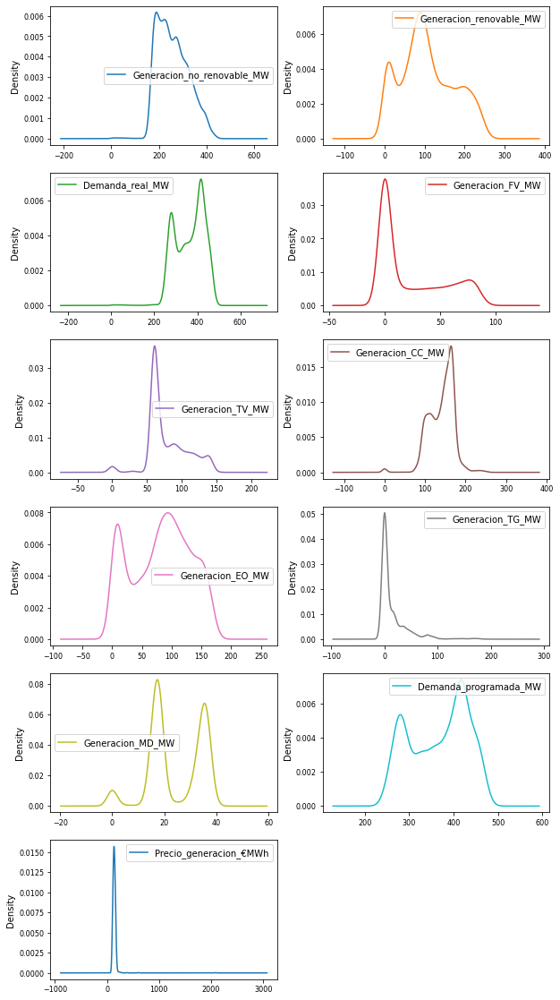

In [76]:
### Escribe aquí tu código ###
density = dataset.plot(kind='kde', subplots=True, legend=True , layout=(6, 2), figsize=(10, 20), sharex=False,
                        fontsize=8, stacked=True)

#plt.savefig('fig/' + 'Density_df_elect_V3.png', dpi=200)

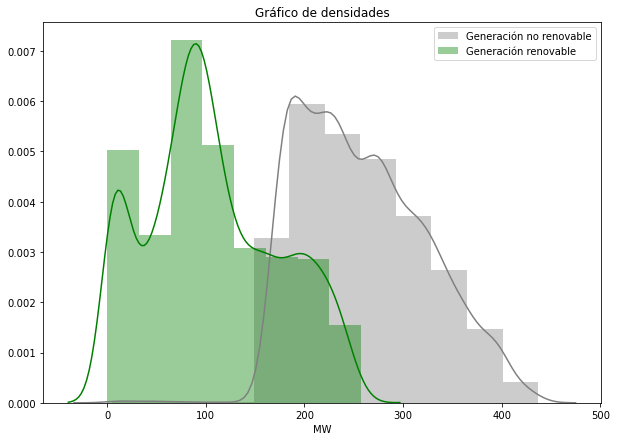

In [77]:
# Generación no renovable, Generación renovable
plt.figure(figsize=(10,7))
vis1 = sns.distplot(dataset["Generacion_no_renovable_MW"], bins=12, color='gray', label='Generación no renovable')
vis2 = sns.distplot(dataset["Generacion_renovable_MW"], bins=8 ,axlabel='MW', color='green', label='Generación renovable')
plt.title('Gráfico de densidades')
plt.legend(loc='best')

#plt.savefig('fig/' + 'Renewable_VS_Conventional_Generation.png', dpi=200)


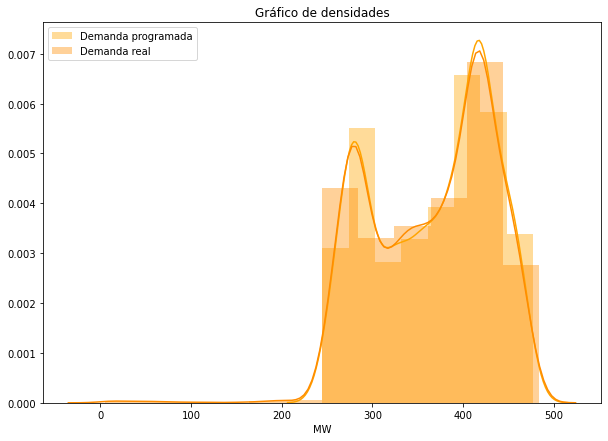

In [78]:
# Demanda programada, Demanda real
plt.figure(figsize=(10,7))
vis1 = sns.distplot(dataset["Demanda_programada_MW"],bins=8, color='orange', label='Demanda programada')
vis2 = sns.distplot(dataset["Demanda_real_MW"],bins=12, axlabel='MW', color='darkorange', label='Demanda real')
plt.title('Gráfico de densidades');
plt.legend(loc='best')

#plt.savefig('fig/' + 'Scheduled_VS_Real_Demand.png', dpi=200)

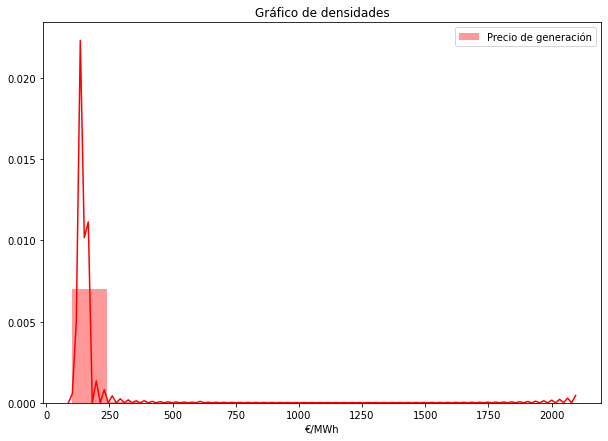

In [79]:
#Precio medio generación

plt.figure(figsize=(10,7))
ax=sns.distplot(dataset["Precio_generacion_€MWh"],hist=True, kde=True, color='red',axlabel='€/MWh',bins=14, label='Precio de generación')

plt.title('Gráfico de densidades');
plt.legend(loc='best')

#plt.savefig('fig/' + 'Generation_Price_Density.png', dpi=200)


**3. ¿Existen outliers? De ser así, analizarlos y tratarlos** 

El boxplot (diagrama de caja) nos permite identificar los valores atípicos y comparar distribuciones. Además, se conoce como se distribuyen el 50% de los valores (dentro de la caja).

* **¿Qué atributo llama la atención por sus valores atípicos?**

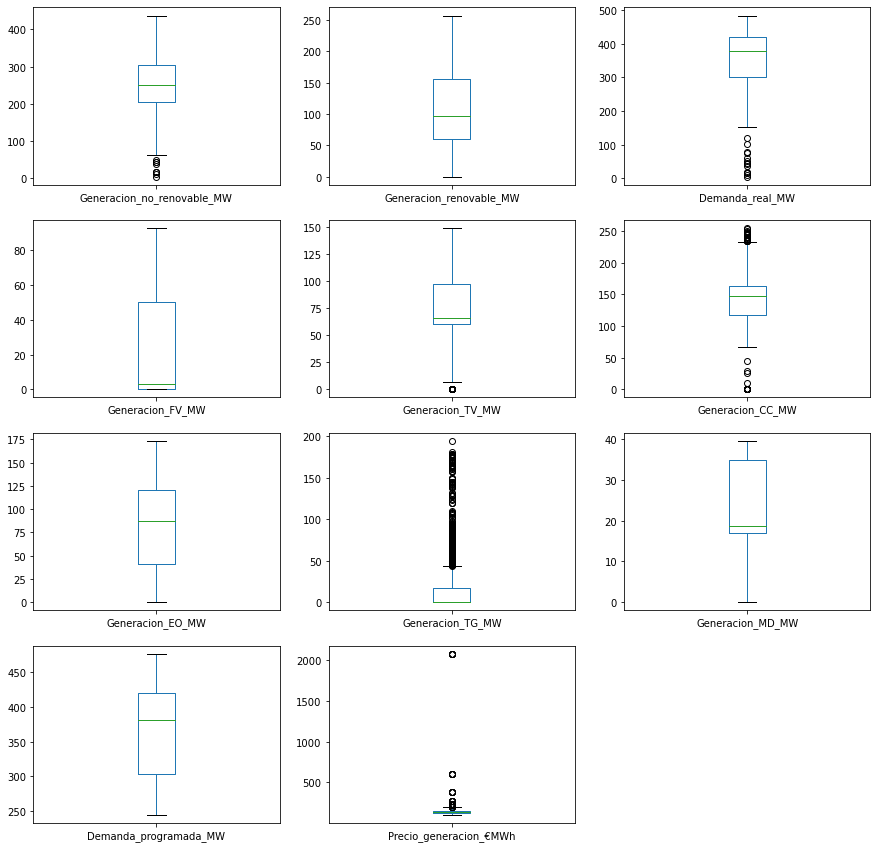

In [80]:
# Graficamos el boxplot de todos los atributos para identificar valores atípicos
atributos_boxplot = dataset.plot(kind='box', subplots=True, layout=(4, 3), figsize=(15, 15), sharex=False,
                                 sharey=False, fontsize=10)

#plt.savefig('fig/' + 'Boxplot_df_elect_V3.png', dpi=200)

Posibles irregularidades a analizar:

- ¿Outliers 'Demanda_real_MW' tienen sentido? ¿Ayudan o confunden al modelo? 
- Analizar también el atributo 'Generacion_no_renovable_MW', los outliers coinciden en el time_series?


In [81]:
#Creamos una función para la detección de outliers con los cuantiles inferiores y superiores deseados

def groupby_outliers(df_in, col_name, qinf=0.25, qsup=0.75):
       q1 = df_in[col_name].quantile(qinf)
       q3 = df_in[col_name].quantile(qsup)
       iqr = q3-q1 #Interquartile range
       fence_low = q1-1.5*iqr
       fence_high = q3+1.5*iqr
       df_out = df_in.loc[(df_in[col_name] < fence_low) | (df_in[col_name] > fence_high)]
       return df_out

#Detectamos los outliers de 'demanda real suma de generación SNP' y los analizamos.

outliers1 = groupby_outliers(dataset, "Demanda_real_MW", 0.3, 0.7)
outliers1

,Generacion_no_renovable_MW,Generacion_renovable_MW,Demanda_real_MW,Generacion_FV_MW,Generacion_TV_MW,Generacion_CC_MW,Generacion_EO_MW,Generacion_TG_MW,Generacion_MD_MW,Demanda_programada_MW,Precio_generacion_€MWh
time_series,,,,,,,,,,,
2020-07-15 10:30:00,4.5,0.0,4.5,0.0,0.0,0.0,0.0,4.5,0.0,433.0,2082.25
2020-07-15 10:40:00,10.4,0.0,10.4,0.0,0.0,0.0,0.0,10.4,0.0,433.0,2082.25
2020-07-15 10:50:00,16.9,0.0,16.9,0.0,0.0,0.0,0.0,16.9,0.0,433.0,2082.25
2020-07-15 11:00:00,16.1,0.0,16.1,0.0,0.0,0.0,0.0,16.1,0.0,441.9,601.97
2020-07-15 11:10:00,17.4,0.0,17.4,0.0,0.0,0.0,0.0,17.4,0.0,441.9,601.97
2020-07-15 11:20:00,43.2,0.0,43.2,0.0,0.0,0.0,0.0,43.2,0.0,441.9,601.97
2020-07-15 11:30:00,37.3,0.0,37.3,0.0,0.0,0.0,0.0,37.3,0.0,441.9,601.97
2020-07-15 11:40:00,44.1,0.0,44.1,0.0,0.0,0.0,0.0,44.1,0.0,441.9,601.97
2020-07-15 11:50:00,50.0,0.0,50.0,0.0,0.0,0.0,0.0,50.0,0.0,441.9,601.97


Estos valores respresentan el blackout que hubo el 29 de septiembre de 2019.
Independientemene, se observan un par de veces valores de generación 0, posiblemente debidos a errores de lectura o del sistema de monitorización.

Si nos fijamos, durante el proceso de raerme del sistema eléctrico solo entra en juego una tecnología de generación (turbina de gas) en la etapa inicial y los precios de generación son desorbitados. Eliminando estas filas, también eliminaremos algunos outliers del atributo 'Precio_generacion_€MWh'.

In [82]:
#Eliminamos los outliers al no ser de utilidad para el modelo.

dataset = dataset.drop(outliers1.index[:])
dataset.describe()

,Generacion_no_renovable_MW,Generacion_renovable_MW,Demanda_real_MW,Generacion_FV_MW,Generacion_TV_MW,Generacion_CC_MW,Generacion_EO_MW,Generacion_TG_MW,Generacion_MD_MW,Demanda_programada_MW,Precio_generacion_€MWh
count,4448.000000,4448.000000,4448.000000,4448.000000,4448.000000,4448.000000,4448.000000,4448.000000,4448.000000,4448.000000,4448.000000
mean,259.414748,106.628530,366.043278,24.094469,79.652046,141.381924,82.534060,14.029856,24.350922,366.865895,138.592017
std,63.133884,66.305595,65.012818,29.916306,28.054366,29.586239,48.871566,26.493303,10.306498,64.599368,54.573700
min,148.600000,0.200000,180.600000,0.000000,0.000000,0.000000,0.200000,0.000000,0.000000,244.600000,100.490000
25%,206.175000,60.300000,303.200000,0.000000,60.400000,118.000000,42.000000,0.000000,17.100000,301.800000,122.030000
50%,250.700000,96.500000,378.300000,3.350000,66.300000,147.650000,87.800000,0.000000,18.600000,380.200000,136.100000
75%,305.225000,156.200000,419.825000,50.600000,97.700000,164.000000,121.000000,17.500000,35.100000,420.300000,150.675000
max,436.800000,257.300000,484.100000,92.700000,148.600000,254.400000,173.400000,194.000000,39.600000,476.900000,2082.250000


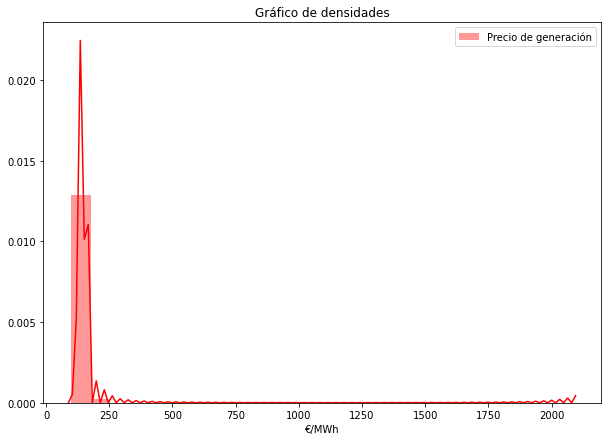

In [83]:
#Precio medio generación

plt.figure(figsize=(10,7))
ax=sns.distplot(dataset["Precio_generacion_€MWh"],hist=True, kde=True, color='red',axlabel='€/MWh',bins=26, label='Precio de generación')

plt.title('Gráfico de densidades');
plt.legend(loc='best')

#plt.savefig('fig/' + 'Generation_Price_Density_V2.png', dpi=200)


Tras eliminar los valores anómalos debidos al blackout que sufrió la isla de Tenerife, se visualiza de nuevo el gráfico de densidades del atributo 'Precio_generacion_€MWh'. Como se puede observar ahora sigue una distribución normal con una desviación típica baja. 

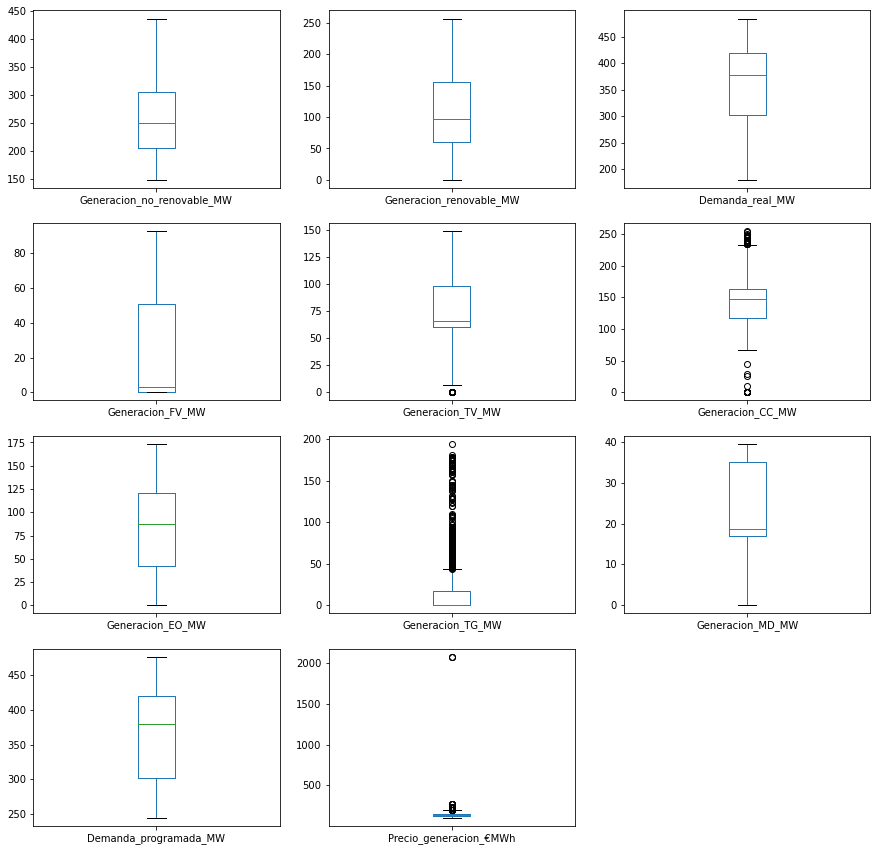

In [84]:
### Escribe aquí tu código ###
atributos_boxplot = dataset.plot(kind='box', subplots=True, layout=(4, 3), figsize=(15, 15), sharex=False,
                                 sharey=False, fontsize=10)

#plt.savefig('fig/' + 'Boxplot_df_elect_V4.png', dpi=200)

Tras eliminar de nuestro dataset las filas donde los valores de "Demanda_real_MW" eran anómalos, se observa que el atributo "Generacion_no_renovable_MW" ya no presenta outliers destacables.

Posibles irregularidades a analizar:

- ¿Outliers Ciclo combinado y turbina de gas tienen sentido? Podría ser pero hay que confirmarlo
- Analizar Outliers precio de generación, decidir si eliminamos valores y cuales eliminamos

In [85]:
outliers2 = groupby_outliers(dataset, "Generacion_CC_MW", 0.2, 0.8)
outliers2

,Generacion_no_renovable_MW,Generacion_renovable_MW,Demanda_real_MW,Generacion_FV_MW,Generacion_TV_MW,Generacion_CC_MW,Generacion_EO_MW,Generacion_TG_MW,Generacion_MD_MW,Demanda_programada_MW,Precio_generacion_€MWh
time_series,,,,,,,,,,,
2020-07-15 09:50:00,188.2,72.6,260.8,19.3,148.6,0.0,53.3,0.0,39.6,412.5,161.83
2020-07-15 10:00:00,188.2,72.5,260.7,19.3,148.6,0.0,53.2,0.0,39.6,433.0,2082.25
2020-07-15 10:10:00,188.2,72.2,260.4,19.0,148.6,0.0,53.2,0.0,39.6,433.0,2082.25
2020-07-15 10:20:00,148.6,72.2,220.8,19.0,148.6,0.0,53.2,0.0,0.0,433.0,2082.25
2020-07-15 13:10:00,180.4,0.2,180.6,0.0,0.0,0.0,0.2,149.1,31.3,461.3,237.68
2020-07-15 13:20:00,210.1,2.2,212.3,0.0,0.0,0.0,2.2,174.7,35.4,461.3,237.68
2020-07-15 13:30:00,231.0,2.6,233.6,0.4,0.0,0.0,2.2,194.0,37.0,461.3,237.68
2020-07-15 13:40:00,202.5,2.6,205.1,0.4,0.0,0.0,2.2,167.4,35.1,461.3,237.68
2020-07-15 13:50:00,196.5,3.3,199.8,0.4,0.0,0.0,2.9,160.5,36.0,461.3,237.68


In [86]:
outliers2.describe()

,Generacion_no_renovable_MW,Generacion_renovable_MW,Demanda_real_MW,Generacion_FV_MW,Generacion_TV_MW,Generacion_CC_MW,Generacion_EO_MW,Generacion_TG_MW,Generacion_MD_MW,Demanda_programada_MW,Precio_generacion_€MWh
count,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000
mean,254.216667,24.912500,279.129167,5.079167,53.791667,65.208333,19.833333,100.987500,34.229167,437.983333,440.396250
std,102.356757,25.441857,94.795076,6.910168,65.916574,109.352195,18.790878,77.228308,7.590124,18.019788,634.761868
min,148.600000,0.200000,180.600000,0.000000,0.000000,0.000000,0.200000,0.000000,0.000000,402.400000,156.290000
25%,188.200000,4.875000,206.150000,0.100000,0.000000,0.000000,4.700000,23.675000,34.675000,430.025000,160.927500
50%,207.000000,12.150000,249.350000,1.200000,0.000000,0.000000,11.800000,146.500000,35.700000,433.000000,219.930000
75%,279.200000,38.225000,312.150000,6.200000,119.425000,83.700000,32.000000,168.375000,36.475000,448.500000,237.680000
max,436.800000,72.600000,442.400000,19.300000,148.600000,254.400000,53.300000,194.000000,39.600000,461.300000,2082.250000


Los outliers del atributo 'Generación T.Real ciclo combinado SNP' suelen coincidir con picos de demanda donde hay media o poca aportación de las energías renovables, un escenario que puede darse en ocasiones y que es interesante que el modelo de aprendizaje analice y tenga en cuenta para la predicción de escenarios futuros.

Se consideran de utilidad por lo que no se eliminan.

In [87]:
outliers3 = groupby_outliers(dataset, "Generacion_TG_MW", 0.2, 0.8)
outliers3.sample(20)

,Generacion_no_renovable_MW,Generacion_renovable_MW,Demanda_real_MW,Generacion_FV_MW,Generacion_TV_MW,Generacion_CC_MW,Generacion_EO_MW,Generacion_TG_MW,Generacion_MD_MW,Demanda_programada_MW,Precio_generacion_€MWh
time_series,,,,,,,,,,,
2020-07-06 11:10:00,347.9,94.0,441.9,56.1,86.4,168.0,37.9,93.5,0.0,440.9,148.91
2020-07-06 14:10:00,292.1,169.1,461.2,80.9,60.4,140.7,88.2,91.0,0.0,445.2,129.96
2020-07-04 16:50:00,205.7,135.0,340.7,28.1,60.3,82.5,106.9,62.9,0.0,342.4,133.88
2020-07-16 09:20:00,378.6,34.3,412.9,13.8,70.9,203.3,20.5,67.6,36.8,414.9,223.77
2020-07-07 14:30:00,373.4,94.2,467.6,75.6,91.3,166.2,18.6,81.1,34.8,462.9,146.97
2020-07-04 12:20:00,222.0,161.3,383.3,33.9,60.3,78.2,127.4,83.5,0.0,380.5,130.52
2020-07-07 16:30:00,350.9,71.6,422.5,62.2,67.2,167.6,9.4,81.1,35.0,423.2,153.51
2020-07-04 10:40:00,256.9,116.3,373.2,16.8,60.2,117.7,99.5,79.0,0.0,364.6,145.08
2020-07-15 13:40:00,202.5,2.6,205.1,0.4,0.0,0.0,2.2,167.4,35.1,461.3,237.68


In [88]:
outliers3.describe()

,Generacion_no_renovable_MW,Generacion_renovable_MW,Demanda_real_MW,Generacion_FV_MW,Generacion_TV_MW,Generacion_CC_MW,Generacion_EO_MW,Generacion_TG_MW,Generacion_MD_MW,Demanda_programada_MW,Precio_generacion_€MWh
count,258.000000,258.000000,258.000000,258.000000,258.000000,258.000000,258.000000,258.000000,258.000000,258.000000,258.000000
mean,310.912791,88.004651,398.917442,34.685271,55.363566,135.746512,53.319380,97.329845,22.472868,410.330620,161.065271
std,63.999192,47.506428,60.620830,26.526181,42.424180,46.021042,41.780959,33.475500,16.829066,42.417407,29.545819
min,171.000000,0.200000,180.600000,0.000000,0.000000,0.000000,0.200000,61.400000,0.000000,282.800000,124.560000
25%,257.875000,53.425000,376.850000,10.750000,0.000000,113.175000,14.925000,78.650000,0.000000,390.500000,145.380000
50%,318.950000,82.200000,417.900000,32.650000,60.400000,151.950000,41.700000,81.800000,34.600000,418.900000,153.510000
75%,358.350000,117.700000,437.750000,58.375000,82.050000,166.775000,90.725000,104.000000,35.900000,443.125000,166.110000
max,436.800000,208.900000,477.700000,81.500000,141.500000,205.200000,152.900000,194.000000,38.400000,474.400000,267.880000


In [89]:
#dataset['datos']='All_data'
outliers2['datos']='Outliers_CC'
outliers3['datos']='Outliers_TG'

df_comparativo = pd.merge(outliers3, outliers2, how='outer', on=['Generacion_no_renovable_MW','Generacion_renovable_MW','Demanda_real_MW','Generacion_FV_MW','Generacion_TV_MW','Generacion_CC_MW','Generacion_EO_MW','Generacion_TG_MW','Generacion_MD_MW','Demanda_programada_MW','Precio_generacion_€MWh'])
#df_comparativo = pd.merge(dataset, outliers2, how='outer',on=['Generacion_no_renovable_MW','Generacion_renovable_MW','Demanda_real_MW','Generacion_FV_MW','Generacion_TV_MW','Generacion_CC_MW','Generacion_EO_MW','Generacion_TG_MW','Generacion_MD_MW','Demanda_programada_MW','Precio_generacion_€MWh'])
#df_comparativo = pd.merge(df_comparativo, outliers3, how='outer', on=['Generacion_no_renovable_MW','Generacion_renovable_MW','Demanda_real_MW','Generacion_FV_MW','Generacion_TV_MW','Generacion_CC_MW','Generacion_EO_MW','Generacion_TG_MW','Generacion_MD_MW','Demanda_programada_MW','Precio_generacion_€MWh'])

df_comparativo = df_comparativo.drop(['Generacion_no_renovable_MW','Generacion_FV_MW','Generacion_TV_MW','Generacion_CC_MW','Generacion_EO_MW','Generacion_TG_MW','Generacion_MD_MW','Demanda_programada_MW','Precio_generacion_€MWh'],axis=1)

df_comparativo.datos_x.fillna(df_comparativo.datos_y, inplace=True)
df_comparativo = df_comparativo.drop(['datos_y'],axis=1)
df_comparativo.columns = ['Generacion_renovable_MW','Demanda_real_MW','Datos']
#df_comparativo.datos.fillna(df_comparativo.datos_y, inplace=True)
#df_comparativo.datos.fillna(df_comparativo.datos_x, inplace=True)
#df_comparativo = df_comparativo.drop(['datos_x','datos_y'],axis=1)


#dataset=dataset.drop(['datos'],axis=1)
outliers2=outliers2.drop(['datos'],axis=1)
outliers3=outliers3.drop(['datos'],axis=1)

df_comparativo


<ipython-input-89-7543ea76f823>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  outliers2['datos']='Outliers_CC'
<ipython-input-89-7543ea76f823>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  outliers3['datos']='Outliers_TG'


,Generacion_renovable_MW,Demanda_real_MW,Datos
0,102.3,359.2,Outliers_TG
1,102.4,364.4,Outliers_TG
2,103.3,367.4,Outliers_TG
3,115.5,369.5,Outliers_TG
4,116.3,373.2,Outliers_TG
...,...,...,...
263,5.6,442.4,Outliers_CC
264,8.3,437.9,Outliers_CC
265,9.0,433.8,Outliers_CC
266,9.4,429.2,Outliers_CC


In [90]:
df_comparativo.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 268 entries, 0 to 267
Data columns (total 3 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Generacion_renovable_MW  268 non-null    float64
 1   Demanda_real_MW          268 non-null    float64
 2   Datos                    268 non-null    object 
dtypes: float64(2), object(1)
memory usage: 8.4+ KB


<Figure size 720x504 with 0 Axes>

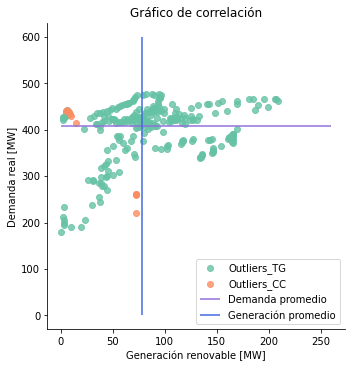

In [91]:
plt.figure(figsize=(10,7))
 
# Use the 'hue' argument to provide a factor variable
sns.lmplot( x="Generacion_renovable_MW", y="Demanda_real_MW", data=df_comparativo, fit_reg=False, hue='Datos', legend=False, palette='Set2')


# Move the legend to an empty part of the plot
plt.hlines(y=409, xmin=0 , xmax=260, colors='mediumpurple',label='Demanda promedio')
plt.vlines(x=78, ymin =0, ymax=600, colors='royalblue',label='Generación promedio')
plt.legend(loc='lower right')
plt.xlabel('Generación renovable [MW]')
plt.ylabel('Demanda real [MW]')
plt.title('Gráfico de correlación')
 
plt.savefig('fig/' + 'Correlation_Outliers.png', dpi=200, bbox_inches="tight")
plt.show()

Los outliers del atributo 'Generación T.Real turbina de gas SNP' suelen coincidir con picos de demanda donde hay media o poca aportación de las energías renovables, un escenario que puede darse en ocasiones y que es interesante que el modelo de aprendizaje analice y tenga en cuenta para la predicción de escenarios futuros.

Se consideran de utilidad por lo que no se eliminan.

In [92]:
outliers4 = groupby_outliers(dataset, "Precio_generacion_€MWh")
outliers4.sample(20)

,Generacion_no_renovable_MW,Generacion_renovable_MW,Demanda_real_MW,Generacion_FV_MW,Generacion_TV_MW,Generacion_CC_MW,Generacion_EO_MW,Generacion_TG_MW,Generacion_MD_MW,Demanda_programada_MW,Precio_generacion_€MWh
time_series,,,,,,,,,,,
2020-07-15 17:50:00,311.7,108.8,420.5,42.8,0.0,107.5,66.0,169.4,34.8,402.5,194.31
2020-07-15 15:20:00,225.6,44.8,270.4,6.5,0.0,29.2,38.3,163.7,32.7,422.6,235.83
2020-07-15 15:00:00,217.5,36.6,254.1,5.6,0.0,9.5,31.0,173.3,34.7,422.6,235.83
2020-07-15 14:20:00,171.0,19.7,190.7,5.0,0.0,0.0,14.7,139.3,31.7,448.5,219.93
2020-07-15 17:20:00,326.2,110.1,436.3,47.2,0.0,132.7,62.9,159.8,33.7,402.5,194.31
2020-07-15 10:00:00,188.2,72.5,260.7,19.3,148.6,0.0,53.2,0.0,39.6,433.0,2082.25
2020-07-19 03:20:00,206.3,75.1,281.4,0.0,119.2,69.2,75.1,0.0,17.9,274.1,195.74
2020-07-15 14:00:00,192.1,3.3,195.4,0.4,0.0,0.0,2.9,157.5,34.6,448.5,219.93
2020-07-15 13:20:00,210.1,2.2,212.3,0.0,0.0,0.0,2.2,174.7,35.4,461.3,237.68


In [93]:
outliers4.describe()

,Generacion_no_renovable_MW,Generacion_renovable_MW,Demanda_real_MW,Generacion_FV_MW,Generacion_TV_MW,Generacion_CC_MW,Generacion_EO_MW,Generacion_TG_MW,Generacion_MD_MW,Demanda_programada_MW,Precio_generacion_€MWh
count,44.000000,44.000000,44.000000,44.000000,44.000000,44.000000,44.000000,44.000000,44.000000,44.000000,44.000000
mean,250.727273,50.604545,301.331818,10.359091,34.377273,80.109091,40.245455,104.184091,32.056818,388.134091,351.361591
std,69.683044,32.195587,82.498738,13.704749,50.181864,71.136321,26.098048,69.500754,7.880957,70.203654,474.196134
min,148.600000,0.200000,180.600000,0.000000,0.000000,0.000000,0.200000,0.000000,0.000000,274.100000,194.310000
25%,195.425000,33.075000,242.850000,0.000000,0.000000,0.000000,20.475000,60.900000,32.650000,282.800000,195.740000
50%,222.950000,43.300000,279.400000,5.850000,0.000000,83.800000,36.200000,142.150000,34.850000,414.900000,223.770000
75%,313.900000,75.575000,402.025000,16.825000,72.175000,133.525000,61.050000,168.750000,36.100000,436.875000,237.680000
max,378.600000,110.100000,455.500000,47.200000,148.600000,203.600000,90.200000,194.000000,39.600000,461.300000,2082.250000


In [94]:
dataset = dataset.drop(outliers4.index[:])
dataset.describe()

,Generacion_no_renovable_MW,Generacion_renovable_MW,Demanda_real_MW,Generacion_FV_MW,Generacion_TV_MW,Generacion_CC_MW,Generacion_EO_MW,Generacion_TG_MW,Generacion_MD_MW,Demanda_programada_MW,Precio_generacion_€MWh
count,4404.000000,4404.000000,4404.000000,4404.000000,4404.000000,4404.000000,4404.000000,4404.000000,4404.000000,4404.000000,4404.000000
mean,259.501544,107.188261,366.689805,24.231698,80.104382,141.994096,82.956562,13.129133,24.273933,366.653406,136.466253
std,63.067709,66.321673,64.499386,30.003178,27.379385,28.227295,48.863039,24.076996,10.299491,64.514205,18.844455
min,159.000000,0.400000,243.100000,0.000000,0.000000,0.000000,0.400000,0.000000,0.000000,244.600000,100.490000
25%,206.350000,61.000000,304.875000,0.000000,60.400000,118.400000,42.675000,0.000000,17.100000,301.800000,121.930000
50%,251.150000,97.100000,378.500000,3.300000,66.400000,147.950000,88.200000,0.000000,18.600000,379.150000,135.850000
75%,305.125000,157.425000,420.100000,51.100000,97.725000,164.025000,121.300000,17.300000,35.000000,420.000000,149.980000
max,436.800000,257.300000,484.100000,92.700000,148.600000,254.400000,173.400000,181.200000,39.600000,476.900000,191.930000


Tras analizar los outliers de los precios medios de generación, no se ve o intuye ninguna relación directa con otro atributo del dataset. Aparentemente parece que este disparo en los precios es debido a un conjunto de factores que es dificil de detectar, por lo que se consideran escenarios de interés para el modelo y no se eliminarán.

## **3. EDA: Exploratory Data Analysisis**



In [24]:
# Definimos una función que nos va a servir más adelante para graficar y visualizar datos

def smart_function(ax, x, y, method, xlabel='', ylabel='', etiqueta='', title='', marker='', style='default'):
    
    if method=='plot':
        ax.plot(x,y,marker,label=etiqueta)
        ax.legend(loc='best', borderaxespad=0.05)
        ax.set_xlabel(xlabel)
        ax.set_ylabel(ylabel)
        ax.set_title(title)
        return ax
    
    elif method=='bar':
        width=0.25
        ax.bar(x,y, width)
        ax.set_xlabel(xlabel)
        ax.set_ylabel(ylabel)
        ax.set_title(title)
        return ax
    
    elif method == 'pie':
        #def func(pct, allvals):
         #   absolute = int(pct/100.*np.sum(allvals))
          #  return "{:.1f}%\n({:d} g)".format(pct, absolute)
        wedges, texts, autotexts = ax.pie(x, autopct='%1.1f%%',textprops=dict(color="w"))
        ax.legend(wedges, y, title=etiqueta, loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))
        plt.setp(autotexts, size=8, weight="bold")
        ax.set_title(title)
        return ax
      
    else:
        print('llamar de nuevo a la función con un método válido')
        

### 1. Mix energético de generación anual

In [25]:
#En primer lugar construimos un diccionario con la generación anual por tencología.

mixgen={}

for i in range(3,9,1):
    mixgen[dataset.columns[i]] = dataset[dataset.columns[i]].mean()*24*365/1000

mixgen


{'Generacion_FV_MW': 189.29495708464714,
 'Generacion_TV_MW': 1083.1553531853333,
 'Generacion_CC_MW': 1521.520950839659,
 'Generacion_EO_MW': 497.6304951829805,
 'Generacion_TG_MW': 104.56696683294633,
 'Generacion_MD_MW': 187.92626754502732}

El diccionario nos muestra la energía total generada en GWh a lo largo del año 2019 según los datos recogidos en el dataset objeto de estudio. Como se puede observar, predominan las energías no renovables en el mix energético.

Habría que analizar históricos previos pero se puede intuir que la integración de las energías renovables ha tenido un impacto positivo en la reducción de la dependencia de las tecnologías más caras y contaminantes.

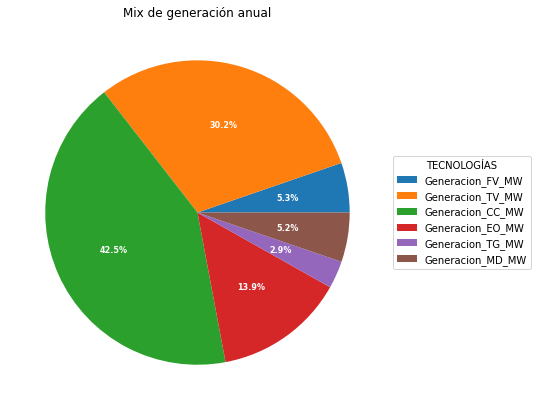

In [26]:
fig, axes = plt.subplots(figsize=(10, 7), subplot_kw=dict(aspect="equal"))

smart_function(axes, mixgen.values(), mixgen.keys(), 'pie','','','TECNOLOGÍAS','Mix de generación anual')

plt.savefig('fig/' + 'Mix_Generation.png', dpi=200)
plt.show()



La penetración de las energías renovables es pequeña en comparación a la península, si es cierto que se trata de un sistema eléctrico más débil que aún presenta una alta dependencia de las energías convencionales y regulables.

Se considera de interés analizar la capacidad de expansión de las energías renovables para la situación actual, sin considerar las restricciones técnicas de la red eléctrica ni la integración de sistemas de almacenamiento para una mejor gestión de la energía.

### 2. Capacidad de expansión de energías renovables

Para analizar la capacidad de expansión de las energías renovables, se considera de interés graficar la curva diaria de generación promediada de fuentes renovables frente a la curva diaria de demanda promediada para cada mes del año 2019.

Mediante los gráficos, se puede observar de forma visual la capacidad de crecimiento de las energías renovables. Se puede analizar para el mes crítico, donde la diferencia entre las curvas sea mínima. Este no es un cálculo exhaustivo pero nos ayuda a tener una idea de la tendencia de crecimiento de las renovables en los próximos años.

Solo se tienen en cuenta datos analíticos, no se tienen en cuenta otros factores como la topología de la red, la disponibilidad de espacio o el recurso disponible.

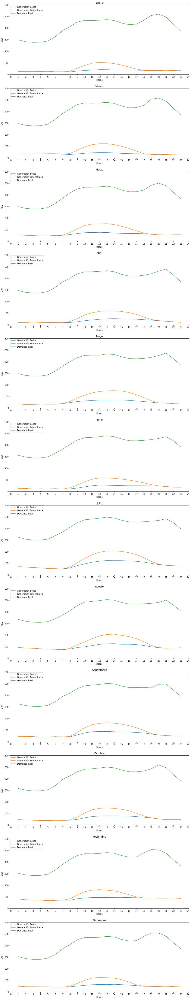

In [27]:
# Primero modificamos la frecuencia de nuestros datos a valores horarios

df_hourly = dataset.resample("H").mean()
mes = ['Enero','Febrero','Marzo','Abril','Mayo','Junio','Julio','Agosto','Septiembre','Octubre','Noviembre','Diciembre']
wind = np.zeros((12,24))
pv = np.zeros((12,24))
load = np.zeros((12,24))
#m=0

fig, axes =plt.subplots(12, 1, figsize=(15,80))
plt.subplots_adjust(left=0.125, bottom=0.1, right=0.9, top=0.9, wspace=0.2, hspace=0.2)
 

for i in range (1,13,1): 
    df_hourly_month = df_hourly[df_hourly.index.month == i]
    for j in range (1,25,1):
        wind[i-1,j-1]=df_hourly_month[df_hourly_month.index.hour == j]['Generacion_EO_MW'].mean()
        pv[i-1,j-1]=df_hourly_month[df_hourly_month.index.hour == j]['Generacion_FV_MW'].mean()
        load[i-1,j-1]=df_hourly_month[df_hourly_month.index.hour == j]['Demanda_real_MW'].mean()
    axes[i-1].plot(np.arange(1,25,1),wind[i-1,:],label='Generación Eólica')
    axes[i-1].plot(np.arange(1,25,1),wind[i-1,:]+pv[i-1,:],label='Generación Fotovoltaica')
    axes[i-1].plot(np.arange(1,25,1),load[i-1,:],label='Demanda Real')
    axes[i-1].legend(loc='upper left', borderaxespad=0.05)
    axes[i-1].set_xlabel('Horas')
    axes[i-1].set_ylabel('MW')
    axes[i-1].set_title(mes[i-1])
    axes[i-1].set_xticks(np.arange(0, 25, step=1))
    axes[i-1].set_ylim(0,600)
    
    #smart_function(axes[i-1],np.arange(1,25,1),wind[i-1,:], 'plot','','','Generación Eólica')
    #smart_function(axes[i-1],np.arange(1,25,1),wind[i-1,:]+pv[i-1,:], 'plot','','','Generación Fotovoltaica')
    #smart_function(axes[i-1],np.arange(1,25,1),load[i-1,:], 'plot','Horas','MW','Demanda Real',mes[i-1])
    
#for k in range (0,6,1):
 #   for l in range (0,2,1):
  #      smart_function(axes[k,l],np.arange(1,25,1),renovable[m,:], 'plot','','','Generación Renovable')
   #     smart_function(axes[k,l],np.arange(1,25,1),demanda[m,:], 'plot','time [h]','Power [MW]','Demanda Real',mes[m])
    #    m=m+1

plt.savefig('fig/' + 'Daily_Demand_VS_Renewables.png', dpi=200)    
plt.show()


Como se puede observar en la figura previa, la curva de generación renovable presenta una forma similar a la curva de demanda, con el pico de demanda al mediodia todos los meses del año. Este hecho favorece al crecimiento de la tecnología verde.

Además, la curva de generación renovable se encuentra muy por debajo a la curva de demanda total lo que significa una baja aportación de las energías renovables. Siguiendo la línea del compromiso con la sostenibilidad y con el objetivo de llevar a cabo la descarbonización del sistema eléctrico, se puede predecir que vamos a ver un crecimiento de la tecnología verde en la isla de Tenerife durante los próximos años. Como dato de interés, recalcar que la generación renovable en las islas canarias ha crecido un 56,3% en el 2019.

Para tener una idea más exacta de la capacidad de crecimiento de la generación renovable en Tenerife, se calcula cual y cuando ha sido el máximo de integración instantánea de energía limpia en Tenerife en el año 2019.



 

In [28]:
# Creamos un nuevo atributo con la aportación instantánea de generación renovable

dataset['Aportacion_renovable_%']=dataset['Generacion_renovable_MW']/dataset['Demanda_real_MW']*100

# Localizamos el máximo de integración instantánea de generación renovable

dataset.loc[dataset['Aportacion_renovable_%'] == dataset['Aportacion_renovable_%'].max()]


,Generacion_no_renovable_MW,Generacion_renovable_MW,Demanda_real_MW,Generacion_FV_MW,Generacion_TV_MW,Generacion_CC_MW,Generacion_EO_MW,Generacion_TG_MW,Generacion_MD_MW,Demanda_programada_MW,Precio_generacion_€MWh,Aportacion_renovable_%
time_series,,,,,,,,,,,,
2019-08-11 15:50:00,150.0,255.2,405.2,75.1,15.3,105.8,180.1,0.0,28.9,410.5,101.58,62.981244


El máximo de integración instantánea de energía limpia en Tenerife se dió el 11 de agosto a las 15:50h con una aportación del 63% de la energía total demandada por la isla.

### 3. Matriz de correlación con los atributos que se consideran más interesantes

En este apartado analizaremos la relación que presentan algunos atributos de interés con el precio medio de la generación en los SNP que es nuestro target o valor objetivo. Como atributos de interés vamos a seleccionar la generación no renovable, la generación solar fotovoltaica, la generación eólica y la demanda real.

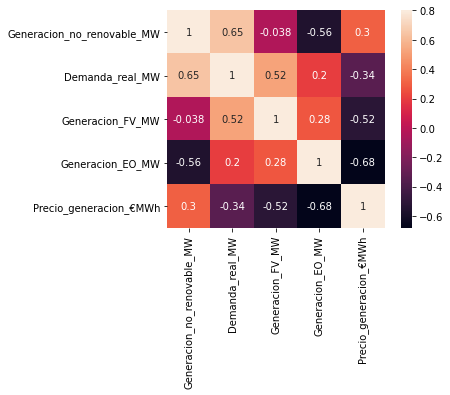

In [29]:
indexes=[0,2,3,6,10] # To plot just 7 of the 13 variables: PRICE, LSTAT, AGE, RM, NOX, INDUS, CRIM.
dataset_reduction = pd.DataFrame(dataset.iloc[:,indexes], columns=dataset.columns[indexes])
corrmat = dataset_reduction.corr()
# Draw the heatmap using seaborn
sns.heatmap(corrmat, vmax=.8, square=True, annot=True)

El atributo con mayor índice de correlación con el precio medio de la generación en los SNP es el de Generación T.Real eólica SNP y es inversamente proporcional, seguido de cerca de la generación fotovoltaica.

Un atributo que llama la atención es el de Demanda real suma de generación SNP. A diferencia de en la peninsula ibérica, este atributo tiene una correlación inversamente proporcional es decir, a mayor demanda menor precio medio de la generación. 



### 4. Análisis del atributo Demanda real suma de generación SNP.

En este punto vamos a analizar el atributo de Demanda real suma de generación SNP. Se va a comparar este atributo con el precio medio de generación SNP para visualizar la relación que presentan de una manera gráfica.

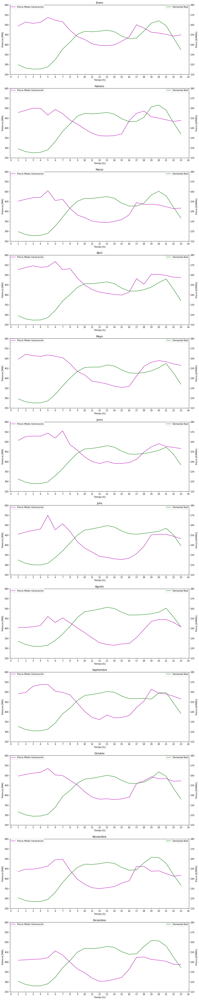

In [30]:
mes = ['Enero','Febrero','Marzo','Abril','Mayo','Junio','Julio','Agosto','Septiembre','Octubre','Noviembre','Diciembre']
price = np.zeros((12,24))
load = np.zeros((12,24))
#m=0

fig, axes =plt.subplots(12, 1, figsize=(15,80))
plt.subplots_adjust(left=0.125, bottom=0.1, right=0.9, top=0.9, wspace=0.2, hspace=0.2)

for i in range (1,13,1):
    df_hourly_month = df_hourly[df_hourly.index.month == i]
    for j in range (1,25,1):
        load[i-1,j-1]=df_hourly_month[df_hourly_month.index.hour == j]['Demanda_real_MW'].mean()
        price[i-1,j-1]=df_hourly_month[df_hourly_month.index.hour == j]['Precio_generacion_€MWh'].mean()
    
    ax1=axes[i-1]
    ax1.plot(np.arange(1,25,1),load[i-1,:],label='Demanda Real', color='g')
    ax1.legend(loc='upper right', borderaxespad=0.05)
    ax1.set_ylabel('Potencia [MW]')
    ax1.set_ylim(250,600)
    ax1.set_xlabel('Tiempo [h]')
    ax1.set_title(mes[i-1])
    ax1.set_xticks(np.arange(0, 25, step=1))
    
    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
    ax2.plot(np.arange(1,25,1),price[i-1,:],label='Precio Medio Generación', color='m')
    ax2.legend(loc='upper left', borderaxespad=0.05)
    ax2.set_ylabel('Precio [€/MWh]')
    ax2.set_ylim(110,180)
    
    
    #smart_function(axes[i-1],np.arange(1,25,1),load[i-1,:], 'plot','','Potencia [MW]','Demanda Real','','-g')
    #plt.subplots_adjust(left=0.2, bottom=0.2, right=0.8, top=0.8, wspace=0.2, hspace=0.2)
    #smart_function(axes[i-1].twinx(),np.arange(1,25,1),price[i-1,:], 'plot','Tiempo [h]','Precio [€/MWh]','Precio medio generación', mes[i-1],'-m')
    #plt.xticks=(np.arange(0, 25, step=1))

#for k in range (0,6,1):
 #   for l in range (0,2,1):
  #      smart_function(axes[k,l],np.arange(1,25,1),renovable[m,:], 'plot','','','Generación Renovable')
   #     smart_function(axes[k,l],np.arange(1,25,1),demanda[m,:], 'plot','time [h]','Power [MW]','Demanda Real',mes[m])
    #    m=m+1
    
plt.savefig('fig/' + 'Daily_Demand_VS_Price.png', dpi=200)        
plt.show()



A diferencia de lo que sucede en el sistema eléctrico de la peninsula ibérica, el atributo ‘Demanda Real’ tiene una correlación inversamente proporcional al precio, es decir, a mayor demanda menor precio medio de generación.

Este escenario es de especial interés y favorece la integración del vehículo eléctrico, así como de sistemas de gestión y almacenamiento de energía. Pues la carga de vehículos durante el periodo nocturno y consecuente aumento de la demanda puede tener un impacto positivo en el precio medio de generación de la isla. 


### 5. Estratificación y visualización del precio medio de generación (Target).

En este punto vamos a estratificar la variable 'Precio_generacion_€MWh' según dia de la semana, mes del año o estación. A continuación se visualizan los datos estratificados en forma de diagrama de cajas para ver si alguna de estas variables categóricas afecta a la variable objeto y en que medida.

In [31]:
dataset['Month']=dataset.index.month
dataset['Weekday']=0
dataset['Season']=0

for i in range (0,len(dataset.index),1):
    dataset['Weekday'][i]=dataset.index[i].isoweekday()
    

    
seasons = {'Verano':(datetime(2019,6,21), datetime(2019,9,22)),
           'Otoño':(datetime(2019,9,23), datetime(2019,12,20)),
           'Primavera':(datetime(2019,3,21), datetime(2019,6,20))}

def get_season(date):
    for season,(season_start, season_end) in seasons.items():
        if date>=season_start and date<= season_end:
            return season
    else:
        return 'Invierno'    
    
# Assuming df has a date column of type `datetime`
dataset['Season'] = dataset.index.map(get_season)



<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Weekday'][i]=dataset.index[i].isoweekday()
<ipython-input-31-bbbc3454b474>:6: Setti

In [32]:
dataset.sample(20)

,Generacion_no_renovable_MW,Generacion_renovable_MW,Demanda_real_MW,Generacion_FV_MW,Generacion_TV_MW,Generacion_CC_MW,Generacion_EO_MW,Generacion_TG_MW,Generacion_MD_MW,Demanda_programada_MW,Precio_generacion_€MWh,Aportacion_renovable_%,Month,Weekday,Season
time_series,,,,,,,,,,,,,,,
2019-06-27 18:30:00,423.6,35.6,459.2,14.8,181.0,188.1,20.8,18.9,35.6,462.5,152.40,7.752613,6,4,Verano
2019-04-10 13:30:00,241.9,240.5,482.4,96.6,79.6,114.3,143.9,15.9,32.1,480.4,124.97,49.854892,4,3,Primavera
2019-07-25 00:30:00,283.8,73.6,357.4,0.0,126.3,154.9,73.6,0.0,2.6,353.0,148.64,20.593173,7,4,Verano
2019-03-30 22:40:00,394.1,0.1,394.2,0.0,178.2,161.9,0.1,18.8,35.2,404.0,153.28,0.025368,3,6,Primavera
2019-11-23 16:50:00,409.7,11.5,421.2,10.7,177.8,172.6,0.8,25.6,33.7,421.9,158.89,2.730294,11,6,Otoño
2019-04-16 02:10:00,278.1,7.0,285.1,0.0,86.9,156.5,7.0,0.0,34.7,279.0,169.15,2.455279,4,2,Primavera
2019-11-30 10:40:00,349.0,106.9,455.9,54.6,123.7,162.4,52.3,45.1,17.8,457.3,157.48,23.448125,11,6,Otoño
2019-06-29 13:20:00,335.5,122.6,458.1,42.4,136.5,152.5,80.2,10.0,36.5,458.0,136.78,26.762716,6,6,Verano
2019-01-14 16:10:00,409.1,39.5,448.6,38.3,199.0,158.7,1.2,16.4,35.0,452.1,146.67,8.805172,1,1,Invierno


In [33]:
dataset.describe()

,Generacion_no_renovable_MW,Generacion_renovable_MW,Demanda_real_MW,Generacion_FV_MW,Generacion_TV_MW,Generacion_CC_MW,Generacion_EO_MW,Generacion_TG_MW,Generacion_MD_MW,Demanda_programada_MW,Precio_generacion_€MWh,Aportacion_renovable_%,Month,Weekday
count,52522.000000,52522.000000,52522.000000,52522.000000,52522.000000,52522.000000,52522.000000,52522.000000,52522.000000,52522.000000,52522.000000,52522.000000,52522.000000,52522.000000
mean,330.727111,78.416148,409.143252,21.609013,123.647871,173.689606,56.807134,11.936868,21.452770,409.627204,147.616681,18.568679,6.524485,3.992536
std,82.004362,67.872114,79.170377,29.825503,45.359021,52.539022,53.238873,17.667290,13.804189,78.815017,18.787490,15.449206,3.448432,1.999139
min,91.000000,0.000000,179.600000,-3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,262.900000,92.190000,0.000000,1.000000,1.000000
25%,273.400000,16.500000,328.800000,0.000000,93.100000,143.700000,6.500000,0.000000,14.700000,330.500000,134.300000,4.321040,4.000000,2.000000
50%,324.600000,64.200000,431.200000,0.000000,122.800000,163.200000,41.000000,0.000000,18.800000,432.400000,147.680000,15.521214,7.000000,4.000000
75%,393.500000,127.400000,477.100000,43.600000,162.100000,202.300000,101.700000,20.700000,34.900000,478.200000,160.810000,30.880656,10.000000,6.000000
max,550.900000,265.600000,572.500000,99.800000,211.700000,396.000000,181.900000,206.500000,40.600000,570.900000,370.480000,62.981244,12.000000,7.000000


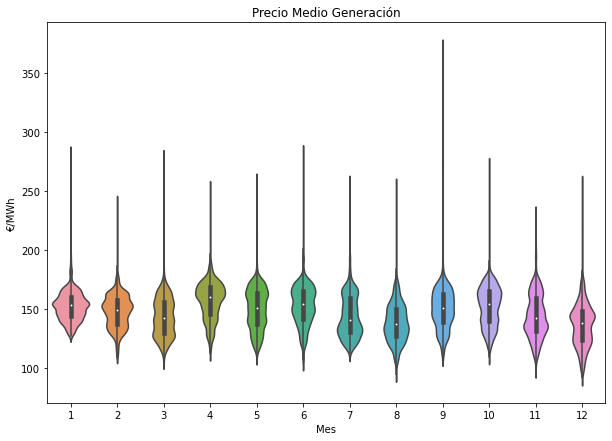

In [34]:
plt.figure(figsize=(10,7))
sns.violinplot(x="Month", y="Precio_generacion_€MWh", data=dataset)
plt.xlabel('Mes')
plt.ylabel('€/MWh')
plt.title('Precio Medio Generación')

plt.savefig('fig/' + 'Monthly_Violinplot_Price.png', dpi=200)        
plt.show()


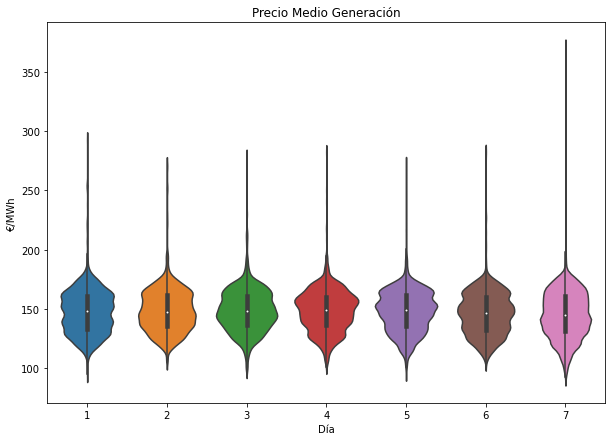

In [35]:
plt.figure(figsize=(10,7))
sns.violinplot(x="Weekday", y="Precio_generacion_€MWh", data=dataset)
plt.xlabel('Día')
plt.ylabel('€/MWh')
plt.title('Precio Medio Generación')

plt.savefig('fig/' + 'Weekday_Violinplot_Price.png', dpi=200)        
plt.show()

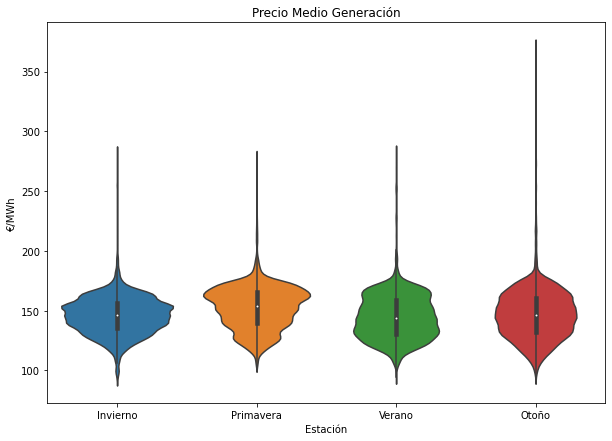

In [36]:
plt.figure(figsize=(10,7))
sns.violinplot(x="Season", y="Precio_generacion_€MWh", data=dataset)
plt.xlabel('Estación')
plt.ylabel('€/MWh')
plt.title('Precio Medio Generación')

plt.savefig('fig/' + 'Seasonal_Violinplot_Price.png', dpi=200)        
plt.show()


Contrariamente a lo esperado y a lo que sucede en la penísnula ibérica, el precio de generación no se ve alterado por la variable categórica de forma clara en ninguno de los tres gráficos previos.

Mientras que la curva diaria del precio de generación si presenta diferentes valores, siguiendo un patrón característico que depende de la hora del dia; cuando se clasifica el atributo ‘Precio_generacion_€MWh’ según variable categórica (día de la semana, mes o estación), no se observa ninguna dependencia clara.

La única variable categórica que parece influir ligeramente en el precio medio de generación, es el mes del año. Aún así, el precio medio de generación presenta poca fluctuación durante todo el año. 


In [44]:
# Guardamos el archivo en formato CSV y Pickle

def save_obj(obj, name ):
       with open('obj/'+ name + '.pkl', 'wb') as f:
           pickle.dump(obj, f, pickle.HIGHEST_PROTOCOL)

#save_obj(dataset, 'df_Tenerife_Electricity_full_2019_clean+EDA')
save_obj(dataset, 'df_Tenerife_Electricity_2020_07_clean+EDA')

#dataset.to_csv('df_Tenerife_Electricity_full_2019_clean+EDA.csv', index=True)
dataset.to_csv('df_Tenerife_Electricity_2020_07_clean+EDA.csv', index=True)